
# Lecture 3 Numerical Basics: Part III 
## Data Science Fundamentals 
## Representation of numbers 

------
 ##### DSF - University of Glasgow - Chris McCaig - 2021/2022

## Floating point numbers - continued
* how to compare floating point numbers
* what machine epsilon is and how it is defined

## Arrays in memory
* what strided arrays are
* how striding allows for indexing and arithmetic operations
* how arrays are laid out in memory
* uses of higher-rank tensors
* how to reshape and reorder higher-rank tensors
* how to use einsum for basic operations

In [50]:
import IPython.display

IPython.display.HTML(
    """
<script>
  function code_toggle() {
    if (code_shown){
      $('div.input').hide('500');
      $('#toggleButton').val('Show Code')
    } else {
      $('div.input').show('500');
      $('#toggleButton').val('Hide Code')
    }
    code_shown = !code_shown
  }

  $( document ).ready(function(){
    code_shown=false;
    $('div.input').hide()
  });
</script>
<form action="javascript:code_toggle()"><input type="submit" id="toggleButton" value="Show Code"></form>"""
)

In [3]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from jhwutils.float_inspector import print_shape_html, print_float, print_float_html
from jhwutils.matrices import show_boxed_tensor_latex, print_matrix
import jhwutils.image_audio as ia
import numpy as np

%matplotlib inline
plt.rc("figure", figsize=(7.0, 3.5), dpi=140)

## Roundoff and precision
Floating point operations can introduce **roundoff error**, because the operations involved have to quantize the results of computations. This can be subtle, because the precision of floating point numbers is variable according to their magnitude; unlike integers, where roundoff is always to the nearest whole number.

<img src="imgs/ieee754.png" width="35%">

*By Ghennessey - Own work, CC BY-SA 4.0, https://commons.wikimedia.org/w/index.php?curid=35324110*

### If you take a standard deviation of a collection of values, does it matter if the values are sorted?

In [5]:
np.random.seed(406324)

x = np.exp(np.random.uniform(-65, 35, 20000))

x_sorted = np.sort(x)
print("Unsorted std. dev: %.6f" % np.std(x))
print("Sorted std. dev:   %.6f" % np.std(x_sorted))

## a terrible order
## alternating largest and smallest
x_bad = np.stack([x_sorted[: len(x) // 2], x_sorted[len(x) // 2 :][::-1]]).T.ravel()
print("Bad std. dev.:     %.6f" % np.std(x_bad))

Unsorted std. dev: 112247720345711.687500
Sorted std. dev:   112247720345711.656250
Bad std. dev.:     112247720345711.640625


### Round off problems

In [9]:
print_float_html(1.0 + 1e-4)  # ok

In [10]:
print_float_html(1.0 + 1e-8)  # ok

In [6]:
print_float_html(1.0 + 1e-16)  # exactly equal to one

In [11]:
print(1e9 + 1e-4)  # ok
print(1e9 + 1e-8)  # exactly equal to 1e9
print(1e9 + 1e-16)  # exactly equal to 1e9

1000000000.0001
1000000000.0
1000000000.0


#### Repeated operations
This can be a real problem when doing repeated operations. Imagine adding dividends to a bank account every second (real time banking!)

In [12]:
balance = 100000000000  # Bill Gates' account

def accumulate_wealth(starting_balance, dividend_per_second, dtype=np.float64):
    balance = np.array(starting_balance, dtype=dtype)
    dividend_per_second = np.array(dividend_per_second, dtype=dtype)
    seconds_in_month = 24 * 60 * 60 * 30
    # run one month's calculation
    for i in range(seconds_in_month):
        balance = balance + dividend_per_second

    print("Apparently earned: $%.2f" % (balance - starting_balance))
    print("Should have earned: $%.2f" % (seconds_in_month * dividend_per_second))

In [13]:
accumulate_wealth(balance, 0.00001)  # got almost twice as much as it should have!

Apparently earned: $39.55
Should have earned: $25.92


In [14]:
accumulate_wealth(balance, 0.000001)  # got nothing at all

Apparently earned: $0.00
Should have earned: $2.59


In [15]:
accumulate_wealth(
    balance, 0.01, dtype=np.float32
)  # apparently lost money! (original balance wasn't exact in float32)

Apparently earned: $-2048.00
Should have earned: $25920.00


#### Financial operations
Moral of the story: **Never** use floating point operations for financial calculations. Use decimal formats, with precisely defined roundoff rules (if roundoff can occur) for financial operations.

### Roundoff error
While this might seem an unlikely scenario, adding repeated tiny offsets to enormous values is exactly the kind of thing that happens in lots of simulations; for example, plotting the trajectory of a satellite with small forces from solar wind acting upon it.

The ordering of operations can be important, with the general rule being to avoid operations of numbers of wildly different magnitudes. 
**This means, in some extreme cases, that the distributive and associative rules don't apply to floating point numbers!**

In [16]:
(1.0e30 + 1.0) - 1.0e30  # wrong, severe roundoff error

In [17]:
(1.0e30 - 1.0e30) + 1.0  # no roundoff error

## Laws of floating-point disaster
Some basic rules:
1. `x+y` will have large error if x and y have different magnitudes (magnitude error)
1. `x-y` will have large error if `x~=y` (cancellation error)

In [18]:
print("Addition")
print(1.0 + 1.0)  # ok
print(1.0 + 1e300)  # bad, rule 1

Addition
2.0
1e+300


In [19]:
print("Subtraction")
print(1000.0 - 1200.0)  # ok
print(5000.0 - 5000.0000000000005)  # bad, rule 2

Subtraction
-200.0
-9.094947017729282e-13


### Don't compare floats with ==

Because of the roundoff errors in floating point numbers, whenever there are comparisons to be made between floating point numbers, it is not appropriate to test for precise equality. This code snippet illustrates the problem:

In [20]:
y = 0.1
z = 300000.0
x = y

x = x + z
x = x - z

# x==y, right?
print(x == y)
print(x - y)

False
-2.3283069916502086e-11


In [21]:
# sometimes the error can be quite extreme,
# if we have a small value and a large value in one operation
x = y + z * z * z
x = x - z * z * z

print(x - y)
print(x)  ## uh oh, x has become 0!

-0.1
0.0


**NEVER USE EQUALITY ON FLOATING POINT VALUES OR ARRAYS!** (unless you are explicitly testing for roundoff error and know what you are doing)

Instead, we **must** always compare floating point numbers by determining if their absolute difference is less than some threshold:
$$|x-y|<\epsilon$$

In [22]:
y = 0.1
z = 300000.0

x = y
x = x + z
x = x - z

eps = 1e-8  # this threshold is often called epsilon
# but is not the same as machine epsilon!

# (1e-8 is not universal, but often reasonable for float64)
# in practice, the choice of epsilon will depend on the application and the operations performed
print(abs(x - y) < 1e-8)

True


However, if results might span many orders of magnitude, a relative test may be more appropriate. There is no one perfect choice.

In [23]:
print(abs(x / y) - 1.0 < 1e-8)  # relative tolerance

True


### Allclose


Testing if all elements of two arrays are within some tolerance is a standard array operation, which NumPy calls `np.allclose(x,y)`. This combines absolute and relative tests in a sensible way.

In [24]:
print(np.allclose(x, y))

True


In [25]:
x = np.full((8, 8), 33341331514515.110)
y = np.full((8, 8), 7452.15415)

z = (x * y * y * y) / (y * y * y)
print(x == z)

[[False False False False False False False False]
 [False False False False False False False False]
 [False False False False False False False False]
 [False False False False False False False False]
 [False False False False False False False False]
 [False False False False False False False False]
 [False False False False False False False False]
 [False False False False False False False False]]


In [26]:
print(np.all(x == z))

False


In [27]:
print(np.allclose(x, z))

True


### Machine precision and $\epsilon$
Just how bad (or good) are floating point numbers at representing real numbers within their range? How close is $\text{float}(\pi)$ to $\pi$?

Floating point representations have a **relative error**, defined by:
<div class="alert alert-box alert-success">
$$
\epsilon = \frac{|\text{float}(x)-x|}{|x|}, 
$$
</div>
the absolute difference between a floating point number and its real counterpart, normalised by the magnitude of the real number.

IEEE 754 guarantees that this error is always less than
<div class="alert alert-box alert-success">
$$
\epsilon \leq \frac{1}{2}2^{-t}, \epsilon \leq 2^{-t-1},
$$
</div>
where $t$ is the number of bits dedicated to the mantissa, excluding the implied 1.

This guarantee applies to both *storage* of numbers (the relative error will never be greater than $\epsilon$) and to *operations* on numbers (that roundoff error in computations will be have relative error $<\epsilon$).

For `float64`, $\epsilon=2^{-53} \approx 1.1\times 10^{16}$.

In [28]:
# we can ask NumPy to print these statistics for us
# note the epsilon term epsneg
print(np.finfo(np.float64))

Machine parameters for float64
---------------------------------------------------------------
precision =  15   resolution = 1.0000000000000001e-15
machep =    -52   eps =        2.2204460492503131e-16
negep =     -53   epsneg =     1.1102230246251565e-16
minexp =  -1022   tiny =       2.2250738585072014e-308
maxexp =   1024   max =        1.7976931348623157e+308
nexp =       11   min =        -max
---------------------------------------------------------------



In [29]:
# check this is indeed the value we expect to see
t = 52
2.0 ** (-t - 1)

# Array layout and structure

# ndarrays
A 256x128x4 array of floating point numbers takes up 1MB  of memory. We can check this:

In [30]:
array = np.zeros((256, 128, 4))

print(array.nbytes)

1048576


(this count ignores any *header* information, which will be a small, nearly constant overhead for any array)

What's actually in that 1MB of memory? How are operations like:

    array.T[:,::2] += 1
    
implemented? 

There are two parts to this problem:
* how **arrays** are represented
* how **numbers** are represented (which Part I covered)

## How arrays are laid out in memory
Multidimensional numerical arrays (`ndarrays` for short) are an **efficient** data structure, in both memory and computational terms.

If we recall the key properties of `ndarrays` from Lecture I:

* fixed, predefined size (or "shape")
* rectangular
* fixed uniform type (all elements have the same type)
* elements are numbers
* arrays are multidimensional

It is important to understand how array datastructures are implemented to understand the impact of operations:

* why is transpose O(1) time, but adding 1 to an array O(N) time? 
* Why does equality testing on arrays not do what you expect? 
* What is the result `np.ones((3,3)) / np.zeros((3,3)`)? 
* Why are ragged arrays not supported?

## Array data structure
Specific implementations differ on exactly how they implement arrays. But a common feature is that the data in the arrays is tightly packed in memory, such that the memory used by an array is a small, constant overhead over the storage of the numbers that make up its elements. There is a short header which describes how the array is laid out in memory, followed by the numerical data.

Efficiency is achieved by packing in the numbers in one long, flat sequence, one after the other. Regardless of whether there is a 1D vector or a 5D tensor, the storage is just a sequence of numbers with a header at the start. 

We can see this flat sequence using `np.ravel()`, which "unravels" an array into the elements as a 1D vector; in reality it is just returning the array as it is stored in memory. (caveat: this isn't quite the order in memory by default; we'll deal with this later).


In [38]:
one_d = np.array([1.0, 2.0, 3.0])

two_d = np.array([[1.0, 2.0, 3.0], 
                  [4.0, 5.0, 6.0], 
                  [7.0, 8.0, 9.0]])

show_boxed_tensor_latex(one_d)
show_boxed_tensor_latex(two_d)

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [39]:
four_d = np.tile(two_d, (3, 2, 1, 1))

show_boxed_tensor_latex(four_d)

<IPython.core.display.Latex object>

In [40]:
print(one_d.ravel())  # obvious enough

[1. 2. 3.]


In [41]:
print(two_d.ravel())  #  rows, then columns

[1. 2. 3. 4. 5. 6. 7. 8. 9.]


In [48]:
print(four_d.ravel())
show_boxed_tensor_latex(four_d)

[1. 2. 3. 4. 5. 6. 7. 8. 9. 1. 2. 3. 4. 5. 6. 7. 8. 9. 1. 2. 3. 4. 5. 6.
 7. 8. 9. 1. 2. 3. 4. 5. 6. 7. 8. 9. 1. 2. 3. 4. 5. 6. 7. 8. 9. 1. 2. 3.
 4. 5. 6. 7. 8. 9.]


<IPython.core.display.Latex object>

### Strides and shape

To implement multidimensional indexing, a key property of arrays,  the standard "trick" is to use **striding**,  with a set of memory offset constants ("strides") which specify how to index into the array, one per axis. This lets the system efficiently index into the array as if it were multidimensional, while keeping it as a single long sequence of numbers packed tightly into memory.

There is one **stride** per dimension, and each stride tells the system how many **bytes** forward to seek to find the next element *for each dimension* (it's called a "stride" because it's how big of a step in memory to take to get to the next element).
For a 1D array, there is one stride, which will be the length of the numeric data type (e.g. 8 bytes for a standard float64).

For a 2D array x, the first element might be 8 (one float), and the second might be `8*x.shape[0]`. In other words, to move to the next column, add 8; to move to the next row, add 8 times the number of columns. Strides are usually given in bytes, not elements, to speed up memory access computations.

<img src="imgs/strided.png" width="45%">

*A strided 2D array*

To find the array element at index [i,j] in a 2D matrix, the memory offset from the start of the number block will be:

    i * stride[0] + j * stride[1]
    
This generalises to higher dimensions (e.g. 3D, 4D tensors). To iterate through an array, the computations can simply increment by the appropriate stride to move to the next elements; for most operations, though, it is sufficient to keep incrementing by the first stride to visit each element in turn.

### Dope fiends
This type of representation is correctly called a **dope vector**, where the **dope vector** refers to the striding information. It is held separately from the data itself; a header which specifies how to index.

The alternative is an **Illife vector**, which uses nested pointers to refer to multidimensional arrays. This is what happens, for example, if we make a list of lists in Python:

    [[1,2,3], [4,5,6], [7,8,8]]
    
The outer list refers to three inner lists.

**Illife vectors** can store ragged arrays trivially (no rectangularity requirement), but are much less efficient for large numerical operations that a form using **dope vectors**.

#### Java Illife vector

    int[][] a = new int[8][8];
    elt_3_4 = a[3][4]

#### Java dope vector

    int [] a = new a[64];
    row_offset = 8;
    elt_3_4 = a[row_offset*3 + 4];


    

### A sketch of an array data structure

A typical structure might look like this (some details omitted). This is written as a C struct, but you can imagine equally well as a Java or Python class. This structure assumes the `dtype` is fixed to `float64` (`double` in C).

    // assume uint is a suitable unsigned integer type,
    // e.g. uint64_t 
    // assume double is IEEE754 float64
    
    struct NDArray        // assumes numbers are all doubles
    {
    
        uint n_dim;       // number of dimensions
        uint n_items;     // total number of elements
        uint item_size;   // size of one element  (in bytes)        
        uint *shape;      // shape, sequence of unsigned ints
        int *strides;     // striding, as a sequence of integers, 
                          // in *bytes* (may be negative!)
        
        double *data;     // pointer to the data array, 
                          // in this case float64 (double)
        
        uint flags;       // any special flags
    };

Most of these are self explanatory; e.g. for a 3x3 array of float64 holding all zeros we would have:

    n_dim = 2          // 2D, i.e. a matrix
    n_items = 9        // 3 * 3 = 9 elements
    item_size = 8      // 8 bytes per float64
    shape = {3,3}      // this is just the shape of the array
    strides = {8, 24}  // the offsets, in bytes, 
                       // to move to the next element in each dimension
    data = {0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0} 
    // we'll ignore flags

### Vectorised operations
Note that many operations can now be defined that just ignore the strides. For example, adding together two arrays:


      // some pseudo code
      if(same_shape(x,y))
      {
          z = zero_array_like(x);
          for(i=0;i<x->n_items;i++)          
                z->data[i] = x->data[i] + y->data[i];        
          return z;
      }

### Strided arrays in practice

This is pretty much how NumPy arrays are implemented, and we can query such properties directly on NumPy arrays:

In [50]:
mat = np.arange(30.0).reshape((6, 5))
print_shape_html(mat)



Shape,"(6, 5)"
Strides,"(40, 8)"
Data type,float64
Elements,30
Num. bytes,240
Bits per element,64
Start offset,0


In [51]:
show_boxed_tensor_latex(mat)

<IPython.core.display.Latex object>

### Transposing
This lets us do some clever things. For example, to transpose an array, all we need to do is to exchange the shape elements and the strides in the header. *The elements themselves are not touched, and the operation takes constant time regardless of array size*. Operations simply *read the memory in a different way* after the transpose.

Or we can reverse the array by setting the memory block pointer to point to the *end* of the array, and then setting the strides to be negative.

### Rigid transformations
Rigid transformations of arrays like flipping and transposing do *not* change the data in the array. They only change the strides used to compute indexing operations. This means they do not depend on the size of the array, and are thus O(1) operations. (technically they are O(D) where D is the number of dimensions of the array)

In [53]:
# now transpose
print("Transposed")
mat_t = mat.T
print_shape_html(mat_t)

Transposed


Shape,"(5, 6)"
Strides,"(8, 40)"
Data type,float64
Elements,30
Num. bytes,240
Bits per element,64
Start offset,0


In [54]:
show_boxed_tensor_latex(mat.T)

<IPython.core.display.Latex object>

In [55]:
# flip
flipud = np.flipud(mat)
print("Flipped up/down")

print_shape_html(flipud)
show_boxed_tensor_latex(flipud)

Flipped up/down


Shape,"(6, 5)"
Strides,"(-40, 8)"
Data type,float64
Elements,30
Num. bytes,240
Bits per element,64
Start offset,25


<IPython.core.display.Latex object>

In [56]:
# flip
print("Flipped left/right")
fliplr = np.fliplr(mat)
print_shape_html(fliplr)
show_boxed_tensor_latex(fliplr)

Flipped left/right


Shape,"(6, 5)"
Strides,"(40, -8)"
Data type,float64
Elements,30
Num. bytes,240
Bits per element,64
Start offset,4


<IPython.core.display.Latex object>

In [57]:
# rot90
rotated = np.rot90(mat)
print("rotated 90")
print_shape_html(rotated)
show_boxed_tensor_latex(rotated)

rotated 90


Shape,"(5, 6)"
Strides,"(-8, 40)"
Data type,float64
Elements,30
Num. bytes,240
Bits per element,64
Start offset,4


<IPython.core.display.Latex object>

### Transpose has time complexity O(1)

In [58]:
N = 100
x = np.zeros((N, N))

In [59]:
%%timeit -n 100
x + 1  # elementwise operation: O(N)

The slowest run took 4.63 times longer than the fastest. This could mean that an intermediate result is being cached.
7.9 µs ± 4.58 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [60]:
%%timeit -n 100
x.T  # stride operation O(1)

372 ns ± 98.5 ns per loop (mean ± std. dev. of 7 runs, 100 loops each)


### C and Fortran order
There is one thing you might have noticed: NumPy gave the strides of the original array as [48,8], *not* [8,48]. This is because the NumPy default (and most common order generally) is that the *last index changes first*.

This applies to any higher dimensional array as well: for example a (512, 512, 3) RGB color image in C order has the memory layout
    
    R -> G -> B -> R G B R G B -> going column-wise
    -> then row-wise


This ordering is called **C ordering** or **row-major**, and is the default in C-based languages. The alternative, where the *first index changes fastest* is called **Fortran ordering** or **column-major** and is sometimes still used in older software.

<img src="imgs/row_column.png">

In other words, iterating over an  array in these orders would work like the following pseudo-code. The elements are stored one after the other; it is just the convention by which we do the indexing computation.

 #### C ordered filling of an 4D tensor [m,n,o,p]
    index = 0
    for mi in range(m):
        for ni in range(n):
            for oi in range(o):
                for pi in range(p):
                    tensor_memory[index] = 0.0
                    index += 1
                    

#### Fortran ordered filling of an 4D tensor [m,n,o,p]
            
    index = 0
    for pi in range(p):
        for oi in range(o):
            for ni in range(n):
                for mi in range(m):
                    tensor_memory[index] = 0.0
                    index += 1
            

In [61]:
x = np.array([[[1, 2, 3], [4, 5, 6], [7, 8, 9]], [[0, 0, 0], [0, 0, 0], [0, 0, 0]]])
show_boxed_tensor_latex(x)

<IPython.core.display.Latex object>

In [62]:
x.ravel(order="C")

array([1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [63]:
x.ravel(order="F")

array([1, 0, 4, 0, 7, 0, 2, 0, 5, 0, 8, 0, 3, 0, 6, 0, 9, 0])

## NumPy types
Unless you specify a different type (e.g. with `dtype=` when calling `np.array` or `np.zeros`, etc.), arrays will be `float64` if they have any floating point value when created, and `int32` otherwise.

An array can be converted using `.astype()`, which will convert the array elements to the specified type.

In [64]:
x = np.array([1, 2, 3])  # no floats, this will be int32
print(x.dtype)

int32


In [65]:
x = np.array([1, 2, 3], dtype=np.int8)  # force to int8
print(x.dtype)

int8


In [66]:
y = np.array([1.0, 2, 3])  # at least one float, will be float64
print(y.dtype)

float64


In [67]:
x_float = x.astype(np.float64)
print(x_float.dtype)
print(x_float)

float64
[1. 2. 3.]


In [68]:
x_float32 = x.astype(np.float32)
print(x_float32.dtype)
print(x_float32)

float32
[1. 2. 3.]


# Example: Brainwaves

<img src="imgs/eeg.jpg" width="15%"> <br><br>
*.[Image](https://flickr.com/photos/tim_uk/8135749317 "EEG Brain Scan") by [Tim Sheerman-Chase](https://flickr.com/people/tim_uk) license [CC BY](https://creativecommons.org/licenses/by/2.0/)*

I have a recording of brain activity from an electroencephalogram (EEG). This consists of a series of electrical measurements, over 16 electrodes arranged on the scalp. Measurements of voltage on the scalp are captured regularly in time at a fixed rate, 512Hz (512 times a second).

In its basic form, the data might be a $N\times D$ matrix for $N$ measurements over time, for each of the $D$ electrodes. One second of data would be a $512\times 16$ matrix in this configuration

Brain activity is very difficult to interpret from these signals. However, gross changes in activity can be seen in the frequencies of oscillation in each electrode (e.g. "alpha wave" activity). The data can be transformed, so that each electrode can be mapped to a number of frequencies each of which has some level of activation. This mapping might generate 64 frequency bands for each electrode. Now 1 second of data might be represented as a $16 \times 64 \times 32$ array, for one second of data. 

In [69]:
eeg_data = np.load("data/jhw_eeg.dat.npz")
time_series = eeg_data["raw_data"]
brain_data = eeg_data["brain_data"]
t = eeg_data["brain_t"]
f = eeg_data["brain_freq"]

Text(0.5, 0, 'Time (seconds)')

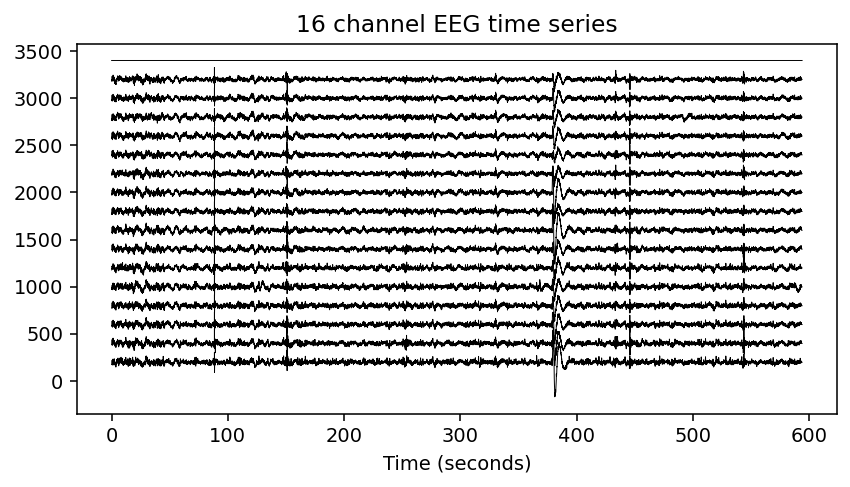

In [70]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)
for i in range(1, 18):
    ax.plot(time_series[:, 0] / 1e3, time_series[:, i] + i * 200, color="k", lw=0.5)
ax.set_title("16 channel EEG time series")
ax.set_xlabel("Time (seconds)")

In [71]:
# 16 channels; 64 frequencies; 166 time steps\
print(brain_data.shape)

(16, 64, 166)


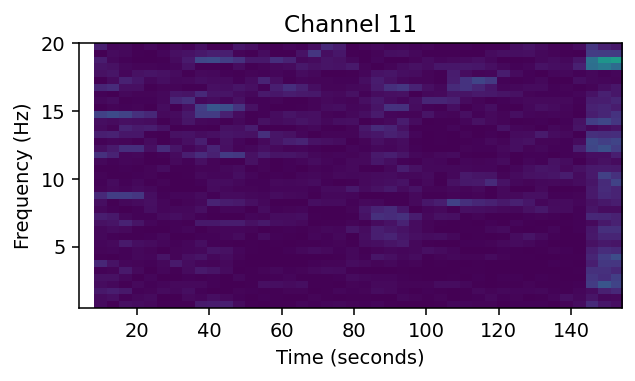

In [79]:
# show a slice of activity from one channel (one electrode)
plt.rc("figure", figsize=(5.0, 2.5), dpi=140)
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)
ax.imshow((brain_data[5, :, :]), origin="upper", aspect="auto", extent=(t[0], t[-1], f[0], f[-1]), vmin=0, vmax=505,)

plt.title("Channel 11")
ax.set_xlabel("Time (seconds)")
ax.set_ylabel("Frequency (Hz)")
ax.set_xlim(4, 154)
ax.set_ylim(0.5, 20)

Now imagine I want to build a machine learning system to classify different kinds of brain signals. This would involve chopping up the signal into small chunks ("features"), and then assembling these chunks into batches. 

One batch might be 10 blocks of 15 timesteps of data; this is a $16 \times 64 \times 15 \times 10\ $ array -- a  rank 4 tensor.  


In [80]:
# chop the brain data into 15 timestep chunks, stacked up in an array
# channels x frequencies x timesteps x chunks
chunk = 15
chunked = brain_data[:, :, :150].reshape(16, 64, chunk, -1)
print(chunked.shape)

(16, 64, 15, 10)


Now I could **reduce**; for example take the median across the time slices *and* across the electrodes.

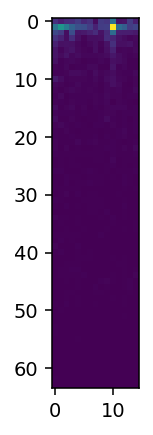

In [86]:
# reduction operation
plt.rc("figure", figsize=(7.0, 3.5), dpi=140)
mean_activation = np.median(chunked, axis=(0, -1))  # compute median across electrodes and chunks
plt.imshow(mean_activation, origin="upper")

# Tensor operations
1D and 2D matrices are reasonably straightforward to work with. But many interesting data science problems like the EEG example involve arrays with higher rank; this is very common in deep learning, for example.

Being able to think about vectorised operations and then mold tensors to the right configurations to do what you want efficiently is a specialised and valuable skill.


## Reshape

As well as "rigid" transformations like `np.fliplr()` and `np.transpose()`, we can also reshape arrays to completely different shapes. The requirement is that the *elements* don't change; **thus the total number of elements cannot change during a reshaping operation.**


Regardless of how many dimensions an array has, it is still inherently a sequence of values; *the shape just changes how it is indexed.* In other words, it just writes a new set of strides. `ravel()` that we saw earlier, will show the "flat" representation:

In [87]:
x = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12])
show_boxed_tensor_latex(x)
print(x.ravel())  # unsurprising

<IPython.core.display.Latex object>

[ 1  2  3  4  5  6  7  8  9 10 11 12]


In [88]:
y = x.reshape((3, 4))
show_boxed_tensor_latex(y)
print(
    y.ravel()
)  # note: order is columns, then rows; always working from the last dimension back to the first

<IPython.core.display.Latex object>

[ 1  2  3  4  5  6  7  8  9 10 11 12]


### Reshaping rules
* The total number of elements will remain unchanged.
* The order of elements will remain unchanged; only the positions at which the array "wraps" into the next dimension.
* The last dimension changes fastest, the second last second fastest, etc.

#### The pouring rule
You can imagine a reshaping operation "pouring" the elements into a new mold. The ordering of the elements is retained, but will fill up the new shape. Pouring fills up the last dimension first.

<img src="imgs/reshape.png" width="70%">

In [89]:
x = np.arange(12)  # 12 elt vector
x3x4 = x.reshape((3, 4))
show_boxed_tensor_latex(x)
show_boxed_tensor_latex(x3x4)

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [90]:
show_boxed_tensor_latex(x.reshape((6, 2)))

<IPython.core.display.Latex object>

In [91]:
show_boxed_tensor_latex(x.reshape((4, 3)))

<IPython.core.display.Latex object>

In [92]:
show_boxed_tensor_latex(x.reshape((2, 3, 2)))  # last dimension, then columns, then rows

<IPython.core.display.Latex object>

In [93]:
show_boxed_tensor_latex(x.reshape((4, 3, 1)))  # Can have 1 in any dimension

<IPython.core.display.Latex object>

In [94]:
show_boxed_tensor_latex(x.reshape((1, 3, 4)))  # A different shape

<IPython.core.display.Latex object>

### Advanced reshaping: squeezing and adding dimensions
Imagine we want to multiply two vectors together (we'll see how this works in detail later). There are two possible orientations for a vector: a **row vector** and a **column vector**. Multiplying a row vector by a column vector results in a matrix (the *outer product*):


In [95]:
x = np.array([1, 2, 3])
y = np.array([-1, 9, 1])
print(np.dot(x, y))  # scalar product, row by row

20


In [96]:
print(np.dot(x, y.T))  # OK, so matrix product -- right?

20


In [97]:
print(y)
print(y.T)  # huh? this does nothing?

[-1  9  1]
[-1  9  1]


Transposing a 1D vector has no effect -- it has only one dimensions and reversing the shape does nothing. So how can we get the effect of a column vector?

In fact, a 1D vector is *neither* a row vector or a column vector. It is just a 1D vector. The operations we might expect are operations on 2D matrices with a **singleton dimension**.

This requires **promoting** the vector to a matrix, by adding a new **singleton dimension**. In less fancy terms, it which just means adding a new dimension with a shape of 1:

In [98]:
y_col = np.reshape(y, (3, 1))  # 3 rows x 1 column
x_col = np.reshape(x, (3, 1))
print_matrix("x\cdot y^T", np.dot(x_col, y_col.T))

<IPython.core.display.Latex object>

### Adding dimensions

Because adding singleton dimensions is so common, there is special syntax for it. You can index an array with an additional dimension to **promote** it to a higher rank, if the
index is given as `None` or `np.newaxis` (they have the same effect). This inserts a new singleton dimension into the strides.

In [99]:
x = np.array([1, 2, 3])  # back to 1D

In [100]:
print(x[:].shape)  # just x
show_boxed_tensor_latex(x)

(3,)


<IPython.core.display.Latex object>

In [101]:
print(x[None, :].shape)  # add a new dimension

(1, 3)


In [102]:
print(x[:, np.newaxis].shape)  # add a new dimension (identical to the above)
show_boxed_tensor_latex(x[:, np.newaxis])

(3, 1)


<IPython.core.display.Latex object>

In [103]:
print(x[None, None, :, None].shape)  # add lots of new dimensions
show_boxed_tensor_latex(x[None, None, :, None])

(1, 1, 3, 1)


<IPython.core.display.Latex object>

What if we want to remove dimensions? We can simply index to do this, as indexing will remove a dimension from a tensor. If there is only element, this just removes the singleton dimension.
    

In [104]:
x_4d = x[None, None, :, None]
show_boxed_tensor_latex(x_4d)
show_boxed_tensor_latex(x_4d[0, 0, :, 0])

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

### Squeezing
Singleton dimensions can get in the way of doing computations easily; often the result of a complex calculation is a multidimensional array with a bunch of singleton dimensions.

**squeezing** just removes *all* singleton dimensions in one go and is performed by `np.squeeze()`


In [105]:
show_boxed_tensor_latex(x_4d)
show_boxed_tensor_latex(np.squeeze(x_4d))  # back to 3 element vector

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [106]:
# 3x4 array
mat3x4 = np.arange(12).reshape((3, 4))
show_boxed_tensor_latex(mat3x4)

<IPython.core.display.Latex object>

In [107]:
# insert some new dimensions (note that we can insert dimensions in between existing ones!)
mat3x4_5d = mat3x4[:, None, None, :, None]

print(mat3x4_5d.shape)
show_boxed_tensor_latex(mat3x4_5d)

(3, 1, 1, 4, 1)


<IPython.core.display.Latex object>

In [148]:
show_boxed_tensor_latex(np.squeeze(mat3x4_5d))

<IPython.core.display.Latex object>

### Elided axes
With large tensors it can be annoying to specify all the intermediate dimensions in an indexing operation, with lots of code that looks like:
    
    img_tensor[0,:,:,:,4]
    
Repeated : can be *elided* in an indexing expression using an *ellipsis* (three dots)

    img_tensor[0, ..., 4]
    
the dots replace as many : as required to make the shape of the index match the shape of the array.
    

In [108]:
mat3x4_5d[0, :, :, :, 0]

array([[[0, 1, 2, 3]]])

In [109]:
mat3x4_5d[0, ..., 0]

array([[[0, 1, 2, 3]]])

In [110]:
mat3x4_5d[0, :, :, 3, 0]

array([[3]])

In [111]:
mat3x4_5d[0, ..., 3, 0]  # ... fills as many dimensions as required

array([[3]])

## Swapping and rearranging axes
We can rearrange the axes of our arrays as we wish, using `np.swapaxes(a, axis1, axis2)` to swap any pair of axes. For example, if we have a colour video, which is of shape `(frames, width,  height,  3)` and we want to apply an operation on each *column*, we can temporarily swap it to the end, broadcast, then swap it back. This is the generalisation of the transpose trick we saw earlier:

In [112]:
x = np.array([[0,0,0], 
              [0,0,1]])
y = np.array([1,2])
(x.T + y).T

array([[1, 1, 1],
       [2, 2, 3]])

    (x.T + y).T   # adds y to every column of x
    
This again is just an operation which rewrites the strides.

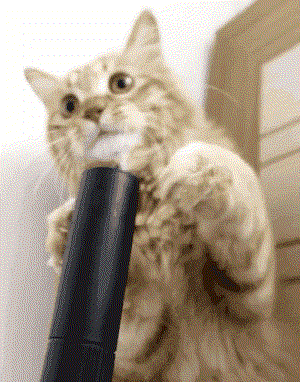

(51, 382, 300, 3)


In [113]:
cat = ia.load_image_colour("imgs/catgif.gif")
ia.show_gif(cat, width="300px")
print(cat.shape)

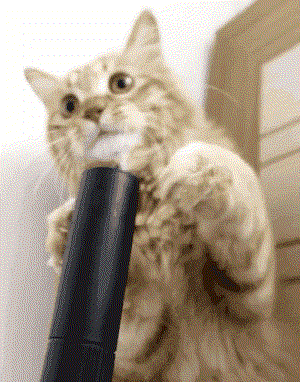

In [114]:
# swap the columns to the end; multiply by a gradient, broadcasting; swap back
gradient_cat = (np.swapaxes(cat, 0, 3) *
                np.linspace(0, 1, cat.shape[0])).swapaxes(3, 0)
ia.show_gif(gradient_cat, width="300px")

Axis rearrangement is (usually) a simple change of the array strides and shape; the array itself is not changed, and so the operations completes in $O(1)$ time.



In [115]:
print(cat.strides)

(2750400, 7200, 24, 8)


In [116]:
# note that all we did was permute the strides in the array
# this is super fast :)
print(cat.swapaxes(1, 3).strides)

(2750400, 8, 24, 7200)


### The swap, reshape, swap dance
Reshape always follows the pouring rule (last dimension pours first). Sometimes that isn't what we want to do. The solution is to:
* rearrange the axes
* reshape the array
* (optionally) rearrange the axes again

Imagine we want to get the cat gif as a film strip, splitting the colour channels into three rows, one for red, green and blue, as if we had three strips of celluloid film. This will be a reshape to size `(H*3, W*Frames)`.


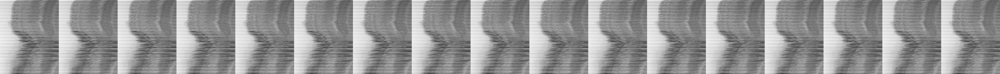

In [118]:
cat_strip = cat.reshape(cat.shape[1] * cat.shape[3],
                        cat.shape[2] * cat.shape[0])
ia.show_image(cat_strip)  # this not be good

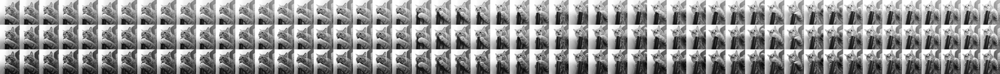

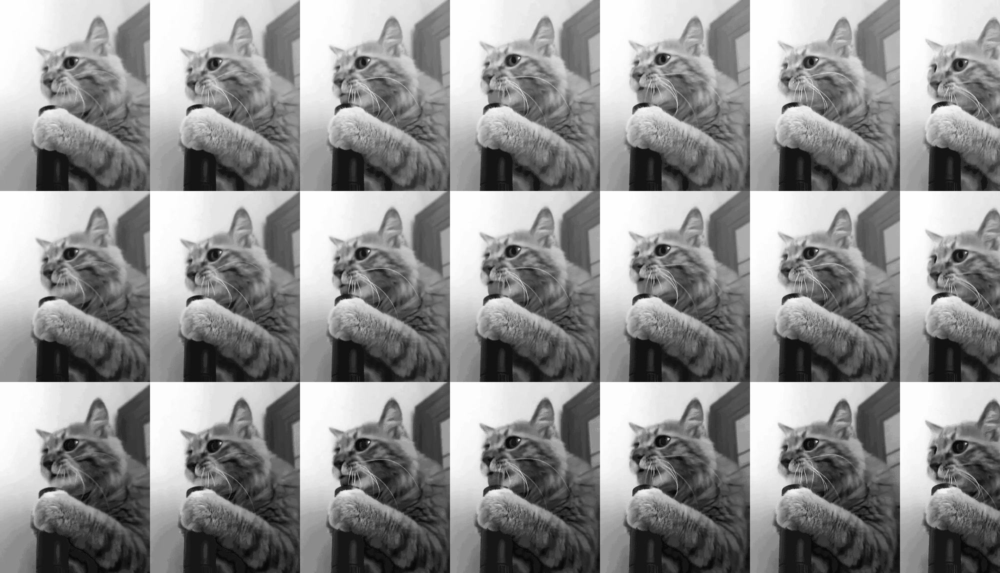

In [119]:
cat_strip = (
    cat.swapaxes(3, 0)
    .swapaxes(2, 3)
    .reshape(cat.shape[1] * cat.shape[3], cat.shape[2] * cat.shape[0])
)
ia.show_image(cat_strip)  # this is correct
ia.show_image(cat_strip[:, :2000])  # zoomed in version

### Einstein summation notation
<img src="imgs/einstein_1921.jpg" width="40%">

*Image credit: public domain, from [Wikimedia Commons](https://upload.wikimedia.org/wikipedia/commons/3/3e/Einstein_1921_by_F_Schmutzer_-_restoration.jpg)*

A very powerful generalisation of these operations is **Einstein summation notation**. This, in its simplest form, is a very easy way to reorder higher-rank tensors. As you can see from the example above, swapping axes gets confusing very fast. Einstein summation notation allows a specification of one letter names for dimensions (usually from `ijklmn...`), and then to write the dimension rearrangement *as a string*.

The notation writes the original order, followed by an `->` arrow, then a new order, like this:

    ijk -> jik

For example, 2D matrix transpose can be written like this:

In [121]:
x = np.array([[1, 2, 3], [4, 5, 6], [7, 8, 9]])
show_boxed_tensor_latex(x)
print()

show_boxed_tensor_latex(x.T)
print()

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [122]:
# switch first and second dimensions
print("Transposed via einsum\n")
show_boxed_tensor_latex(np.einsum("ij -> ji", x))

Transposed via einsum



<IPython.core.display.Latex object>

In [123]:

# einsum is really useful for higher order arrays
y = np.zeros((5, 4, 10, 10))
y_rearranged = np.einsum("ijkl -> jlik", y)
print("Y shape", y.shape)
print("Y strides", y.strides)
print()
print("Y rearranged", y_rearranged.shape)
print("Y rearranged strides", y_rearranged.strides)

Y shape (5, 4, 10, 10)
Y strides (3200, 800, 80, 8)

Y rearranged (4, 10, 5, 10)
Y rearranged strides (800, 8, 3200, 80)


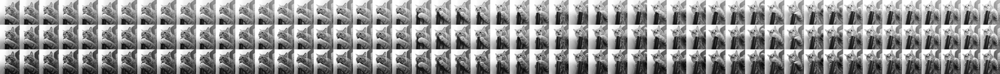

In [124]:
# slightly easier to understand
# we switch from
# (f)rames, (r)ows, (c)olumns, (C)olours to
# (C)olours, (r)ows, (f)rames, (c)columns
cat_strip = np.einsum("frcC->Crfc", cat).reshape(
    cat.shape[1] * cat.shape[3], cat.shape[2] * cat.shape[0]
)
ia.show_image(cat_strip)

### Extreme einsumming
`einsum` can also compute summations, products and diagonalisations in one single command, but this is beyond what we will cover in DSF.

The power of `einsum` leverages the flexibility of the `ndarray` strided array structure. It makes a huge range of operations possible in a very compact form.

#### Optional reading
Read **A guide to Einstein sums** http://ajcr.net/Basic-guide-to-einsum/  if you want more details on using `np.einsum`.



# Resources for this lecture
* **From Python to Numpy** http://www.labri.fr/perso/nrougier/from-python-to-numpy/ *recommended reading*

---

* **Floating point numbers** http://pmihaylov.com/floating-point-numbers/ (floats)
* **What Every Computer Scientist Should Know About Floating Point Numbers** http://docs.oracle.com/cd/E19957-01/806-3568/ncg_goldberg.html

## Advanced (beyond this course)
* **Advanced NumPy** http://www.scipy-lectures.org/advanced/advanced_numpy/
* **NumPy tricks** http://arogozhnikov.github.io/2015/09/29/NumpyTipsAndTricks1.html and http://arogozhnikov.github.io/2015/09/30/NumpyTipsAndTricks2.html